# EP 1

Marcus Vinicius Fugagnoli Laranjeira - Número USP 5383459

## Tabela Global Sumária

* **Nome das classes**: 'Lâmpada', 'Post-It', 'Chave de Fenda', 'Cadeado', 'Rolha', 'Pincel', 'Caneta' e 'Pilha'
* **Número de classes**: 10
* **Número de imagens**: 600
* **Tamanho da base (bytes)**: 330MB;
* **Resolução das imagens**: 600 linhas por 800 colunas (480.000 pixels)

Parte dos metadados foi calculado e incluído no presente Notebook.

O [Dicionário de Dados](#Dicionário-de-Dados) se encontra no final deste documento.

In [1]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import pandas as pd

In [2]:
# Caminho para o subdiretório das imagens
subdir = "./imagens/"

In [3]:
metadados = pd.read_csv('metadados.csv')
metadados.drop(['Número'], axis = 1, inplace = True)

In [4]:
display(metadados.head(5))
display(metadados.tail(5))

,Grupo,Descrição,Nome Arquivo,Classe 1,Classe 2,Classe 3,Plano de Fundo,Luz,Ambiente
0,1,"Lâmpada, Post-It, Chave de Fenda",0001.png,Lâmpada,Post-It,Chave de Fenda,Madeira,Amarela,Interno
1,1,"Lâmpada, Post-It, Cadeado",0002.png,Lâmpada,Post-It,Cadeado,Madeira,Amarela,Interno
2,1,"Lâmpada, Post-It, Rolha",0003.png,Lâmpada,Post-It,Rolha,Madeira,Amarela,Interno
3,1,"Lâmpada, Post-It, Pincel",0004.png,Lâmpada,Post-It,Pincel,Madeira,Amarela,Interno
4,1,"Lâmpada, Post-It, Caneta",0005.png,Lâmpada,Post-It,Caneta,Madeira,Amarela,Interno


,Grupo,Descrição,Nome Arquivo,Classe 1,Classe 2,Classe 3,Plano de Fundo,Luz,Ambiente
595,5,"Pincel, Pinça, Pendrive",0596.png,Pincel,Pinça,Pendrive,Pedra,Sol,Externo
596,5,"Caneta, Pilha, Pinça",0597.png,Caneta,Pilha,Pinça,Pedra,Sol,Externo
597,5,"Caneta, Pilha, Pendrive",0598.png,Caneta,Pilha,Pendrive,Pedra,Sol,Externo
598,5,"Caneta, Pinça, Pendrive",0599.png,Caneta,Pinça,Pendrive,Pedra,Sol,Externo
599,5,"Pilha, Pinça, Pendrive",0600.png,Pilha,Pinça,Pendrive,Pedra,Sol,Externo


## Visualização Ampla das Imagens

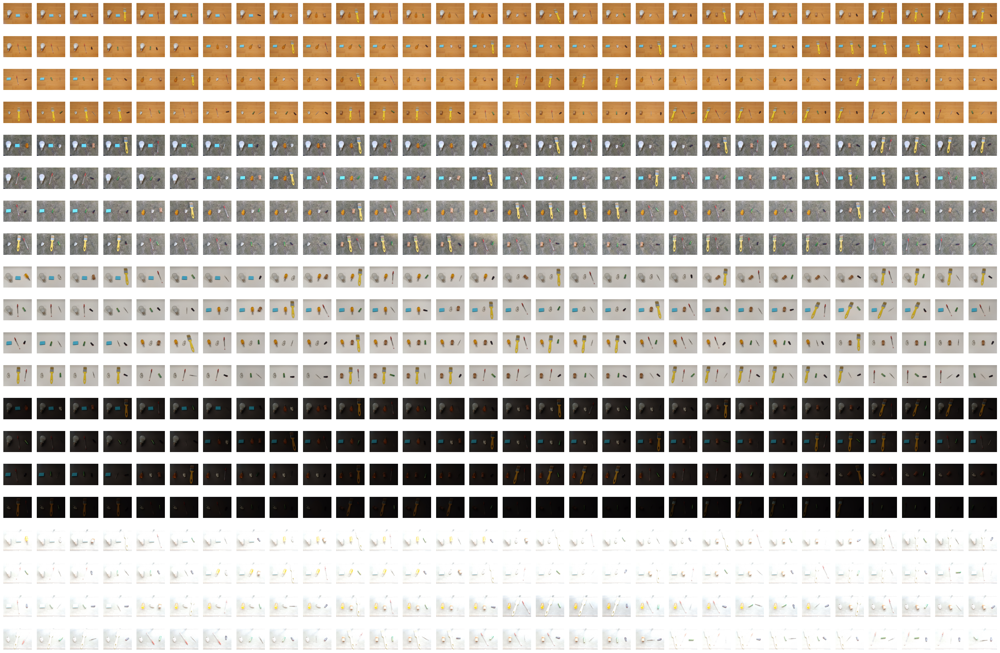

In [5]:
fig, axs = plt.subplots(20, 30, figsize=(30, 20))

for i in range(0, len(metadados['Nome Arquivo'])):
    # Calculando o índice da linha e da coluna
    linha = i // 30
    coluna = i % 30

    nome_arquivo = metadados['Nome Arquivo'][i]
    caminho_imagem = os.path.join(subdir, nome_arquivo)
    imagem = mpimg.imread(caminho_imagem)

    axs[linha, coluna].imshow(imagem)
    axs[linha, coluna].axis('off')

plt.tight_layout()
plt.show()

## Construção dos Metadados Faltantes

### Estudo do histograma por grupo

Para fins de análise e comparação entre os grupos de fotos, calculo o histograma médio de cada canal, por foto e então do grupo todo.

In [6]:
# Defino uma função para classificar o histograma quanto ao brilho aparente
# Essa classificação foi empírica e não seguiu nenhuma teoria ou determinação
# rígida, apenas visual para fins de classificação deste trabalho

def classificar_histograma(mediana, media):
    if 64 <= mediana <= 192 and 64 <= media <= 192:
        return 'Equilibrado'
    elif mediana < 64 and media < 64:
        return 'Escuro'
    elif mediana > 192 and media > 192:
        return 'Claro'
    else:
        return 'Indefinido'

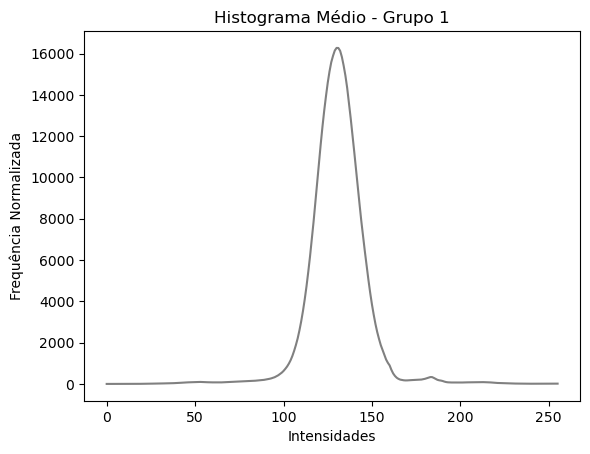

Grupo 1:
Média do histograma: 131
Mediana do histograma: 131
Brilho: Equilibrado



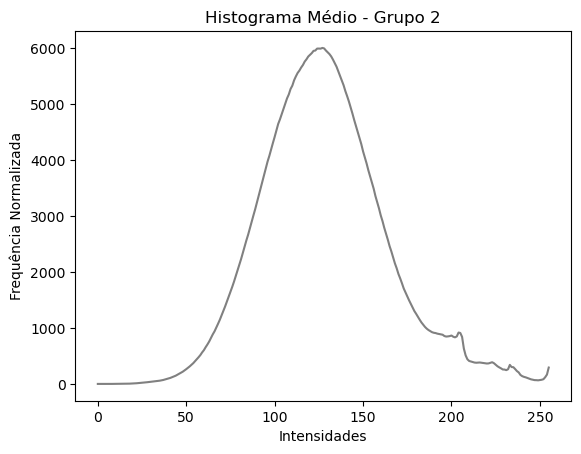

Grupo 2:
Média do histograma: 129
Mediana do histograma: 126
Brilho: Equilibrado



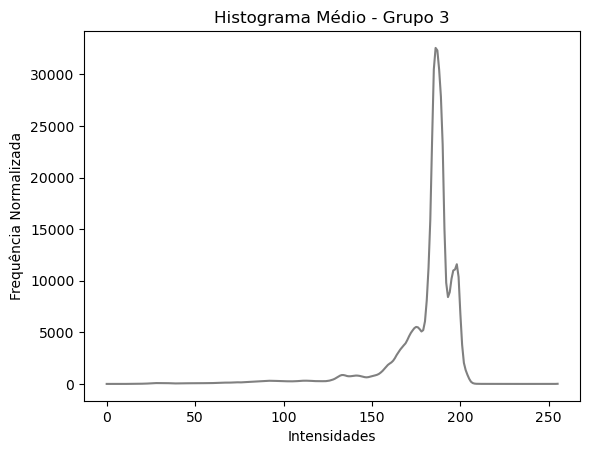

Grupo 3:
Média do histograma: 180
Mediana do histograma: 186
Brilho: Equilibrado



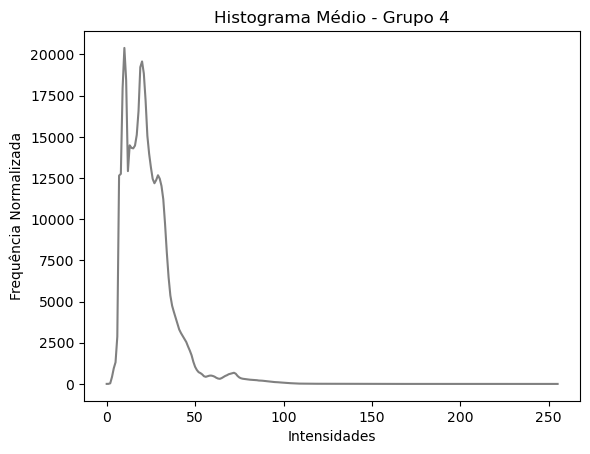

Grupo 4:
Média do histograma: 24
Mediana do histograma: 21
Brilho: Escuro



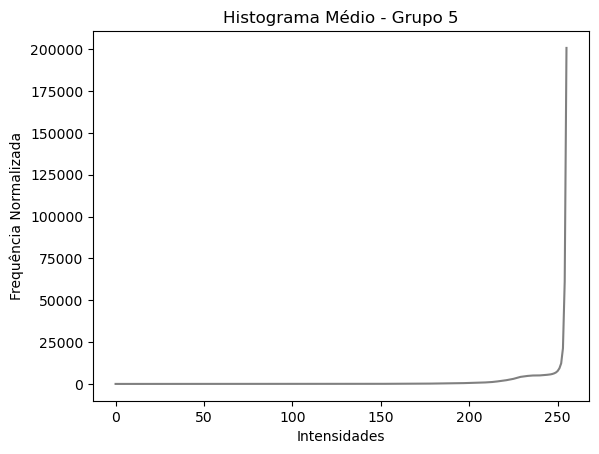

Grupo 5:
Média do histograma: 246
Mediana do histograma: 254
Brilho: Claro



In [7]:
grupos = [metadados.iloc[i:i+120] for i in range(0, len(metadados), 120)]

media_histograma = []
mediana_histograma = []
classificacao_histograma = []

# Para cada foto, calculo o histograma médio dos 3 canais R, G e B e então calculo o histograma médio do grupo
for i, grupo in enumerate(grupos):

    histogramas = []

    for nome_arquivo in grupo['Nome Arquivo']:
        caminho_imagem = os.path.join(subdir, nome_arquivo)
        imagem = mpimg.imread(caminho_imagem).astype(np.float32)
        imagem *= 255 # o matplotlib carrega ela normalizada de 0 a 1

        # Calcular o histograma médio dos 3 canais da imagem
        hist = np.histogram(((imagem[:,:,0] + imagem[:,:,1] + imagem[:,:,2]) / 3), bins = 256, range = (0, 256))

        # Adicionar a luminosidade média aos valores de luminosidade do grupo
        histogramas.append(hist)

    # Calculo a média, a mediana do histograma para o grupo e também defino a classificação
    soma_histogramas = np.zeros(256)
    for h in histogramas:
        soma_histogramas += h[0]

    histograma_medio = soma_histogramas / len(histogramas)
    
    media_histograma.append(round(np.sum(np.arange(256) * (histograma_medio/np.sum(histograma_medio)))))
    mediana_histograma.append(np.argmax(np.cumsum(histograma_medio / np.sum(histograma_medio)) >= 0.5))
    classificacao_histograma.append(classificar_histograma(media_histograma[i], mediana_histograma[i]))

    # Plot do histograma médio para o grupo
    plt.figure()
    plt.title(f'Histograma Médio - Grupo {i + 1}')
    plt.plot(np.arange(256), histograma_medio, color = 'gray')
    plt.xlabel('Intensidades')
    plt.ylabel('Frequência Normalizada')
    plt.show()

    # Média, a mediana e classificação de brilho para o grupo
    print(f'Grupo {i + 1}:')
    print(f'Média do histograma: {media_histograma[i]}')
    print(f'Mediana do histograma: {mediana_histograma[i]}')
    print(f'Brilho: {classificacao_histograma[i]}\n')


In [8]:
# Atualizo os metadados com os rótulos de brilho, as médias e medianas dos histogramas para cada imagem de acordo com seu grupo
for i in range(0, len(metadados)):
    metadados.loc[i, 'Média Histograma'] = media_histograma[i // 120]
    metadados.loc[i, 'Mediana Histograma'] = mediana_histograma[i // 120]
    metadados.loc[i, 'Brilho'] = classificacao_histograma[i // 120]

metadados['Média Histograma'] = metadados['Média Histograma'].astype(int)
metadados['Mediana Histograma'] = metadados['Mediana Histograma'].astype(int)

## Exemplos de metadados de 2 imagens de cada grupo 

In [9]:
display(pd.concat([metadados.iloc[73:75], metadados.iloc[230:232],
                   metadados.iloc[337:339], metadados.iloc[393:395],
                   metadados.iloc[543:545]]))

,Grupo,Descrição,Nome Arquivo,Classe 1,Classe 2,Classe 3,Plano de Fundo,Luz,Ambiente,Média Histograma,Mediana Histograma,Brilho
73,1,"Chave de Fenda, Rolha, Pinça",0074.png,Chave de Fenda,Rolha,Pinça,Madeira,Amarela,Interno,131,131,Equilibrado
74,1,"Chave de Fenda, Rolha, Pendrive",0075.png,Chave de Fenda,Rolha,Pendrive,Madeira,Amarela,Interno,131,131,Equilibrado
230,2,"Pincel, Caneta, Pilha",0231.png,Pincel,Caneta,Pilha,Concreto,Sombra,Externo,129,126,Equilibrado
231,2,"Pincel, Caneta, Pinça",0232.png,Pincel,Caneta,Pinça,Concreto,Sombra,Externo,129,126,Equilibrado
337,3,"Cadeado, Pilha, Pinça",0338.png,Cadeado,Pilha,Pinça,Branco,Branca,Interno,180,186,Equilibrado
338,3,"Cadeado, Pilha, Pendrive",0339.png,Cadeado,Pilha,Pendrive,Branco,Branca,Interno,180,186,Equilibrado
393,4,"Lâmpada, Pilha, Pinça",0394.png,Lâmpada,Pilha,Pinça,Cimento,Indireta,Interno,24,21,Escuro
394,4,"Lâmpada, Pilha, Pendrive",0395.png,Lâmpada,Pilha,Pendrive,Cimento,Indireta,Interno,24,21,Escuro
543,5,"Post-It, Pinça, Pendrive",0544.png,Post-It,Pinça,Pendrive,Pedra,Sol,Externo,246,254,Claro
544,5,"Chave de Fenda, Cadeado, Rolha",0545.png,Chave de Fenda,Cadeado,Rolha,Pedra,Sol,Externo,246,254,Claro


## Imagens Separadas por Classes

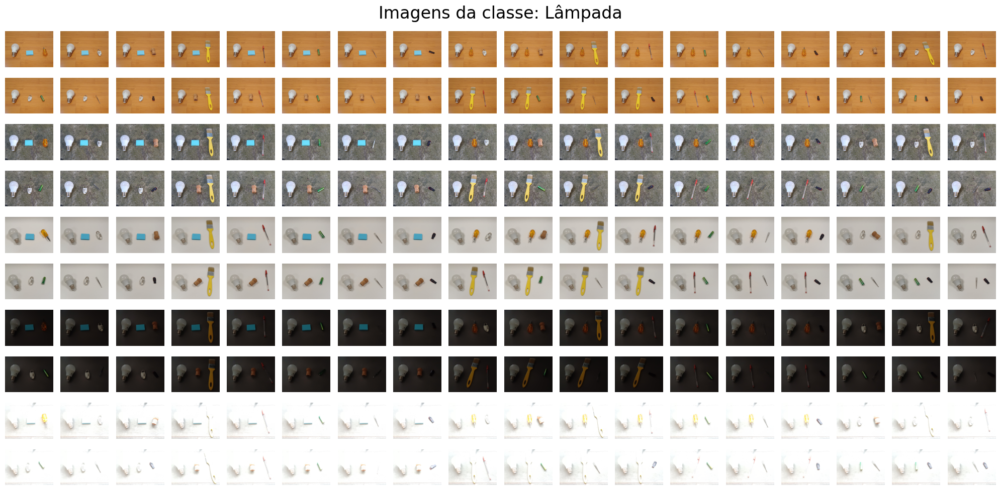

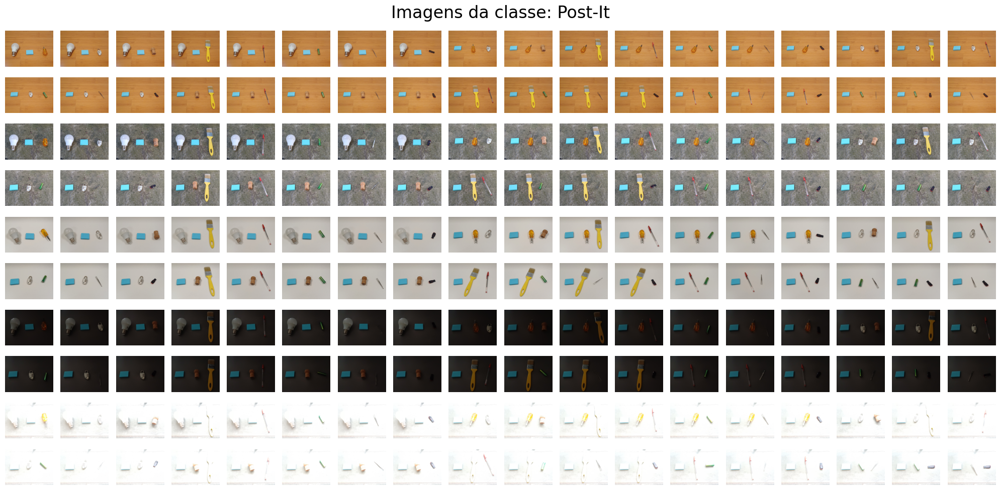

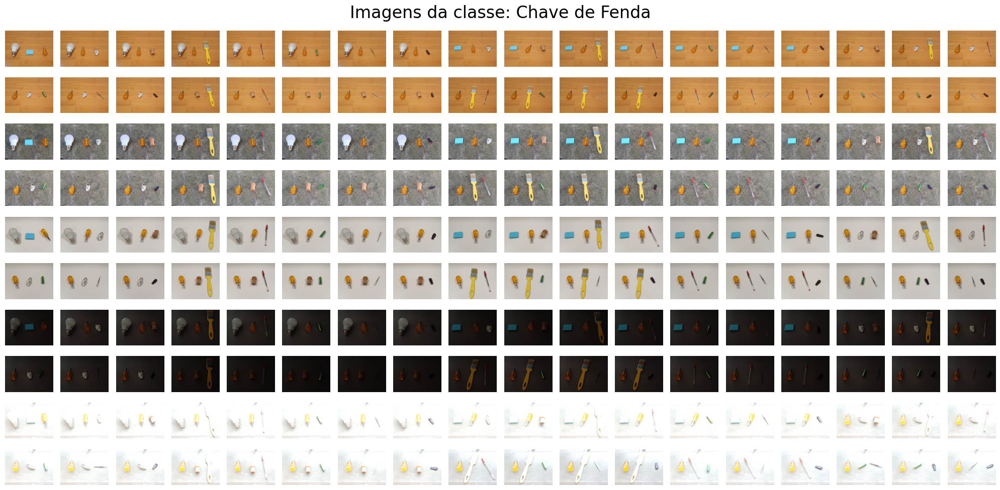

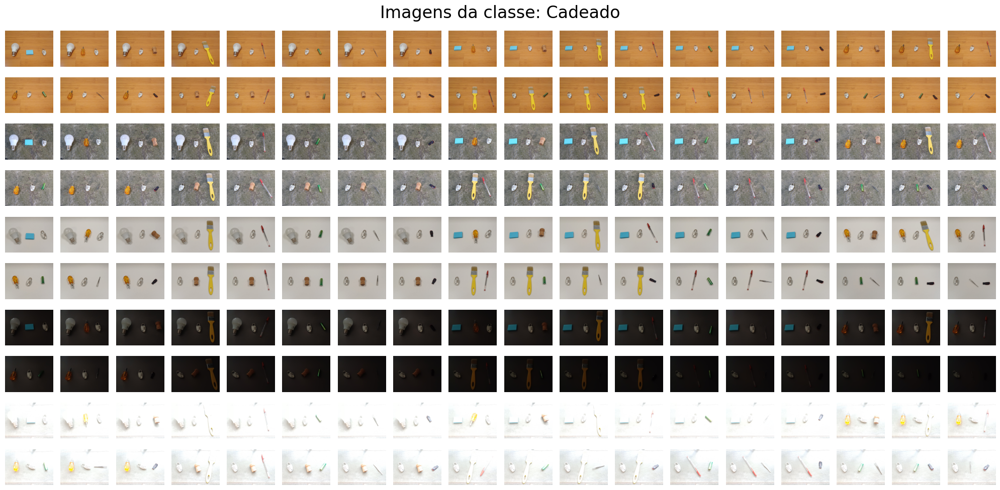

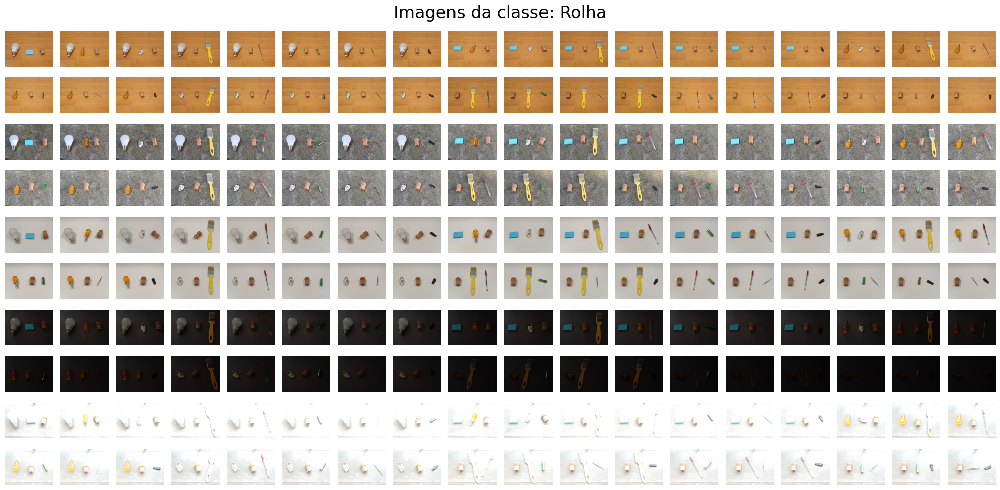

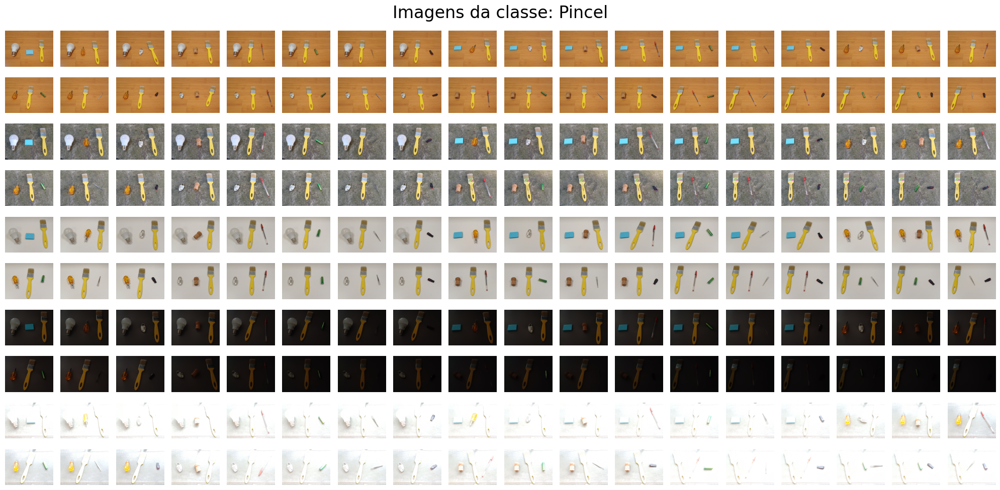

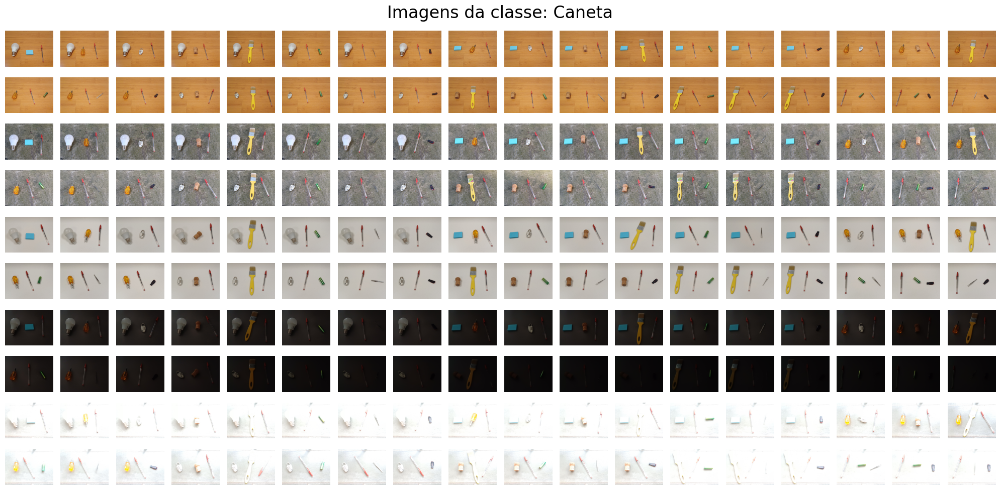

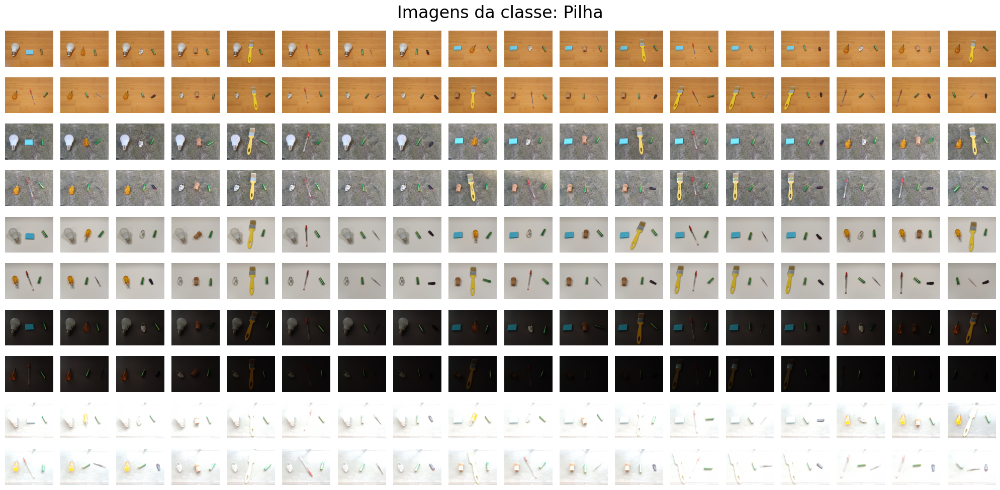

In [10]:
# Todas as 3 colunas Classe 1, Classe 2 e Classe 3 tem repetições das classes disponíveis
# Para esta demonstração, utilizamos a coluna Classe 1 para enumerar todas as classes
for classe in metadados['Classe 1'].unique():
    
    imagens_por_classe = metadados[metadados.isin([classe]).any(axis=1)]["Nome Arquivo"]
    qtd_imagens = len(imagens_por_classe)
    
    if qtd_imagens == 0:
        print(f"Não há imagens para a classe: {class_name}")
    else:
        colunas = 18
        linhas = (qtd_imagens - 1) // colunas + 1
        fig, axes = plt.subplots(linhas, colunas, figsize = (20, 10))
        fig.suptitle(f"Imagens da classe: {classe}", fontsize = 24)

        for i, nome_arquivo in enumerate(imagens_por_classe):
            ax = axes[i // colunas, i % colunas] if linhas > 1 else axes[i % colunas]
            caminho_imagem = os.path.join(subdir, nome_arquivo)
            imagem = mpimg.imread(caminho_imagem)
            ax.imshow(imagem)
            ax.axis("off")

        plt.tight_layout()
        plt.show()


## Exemplo de Imagem por Classe

Abaixo mostro uma imagem de cada classe 1 do grupo 1, contabilizando 1 imagem de cada classe.

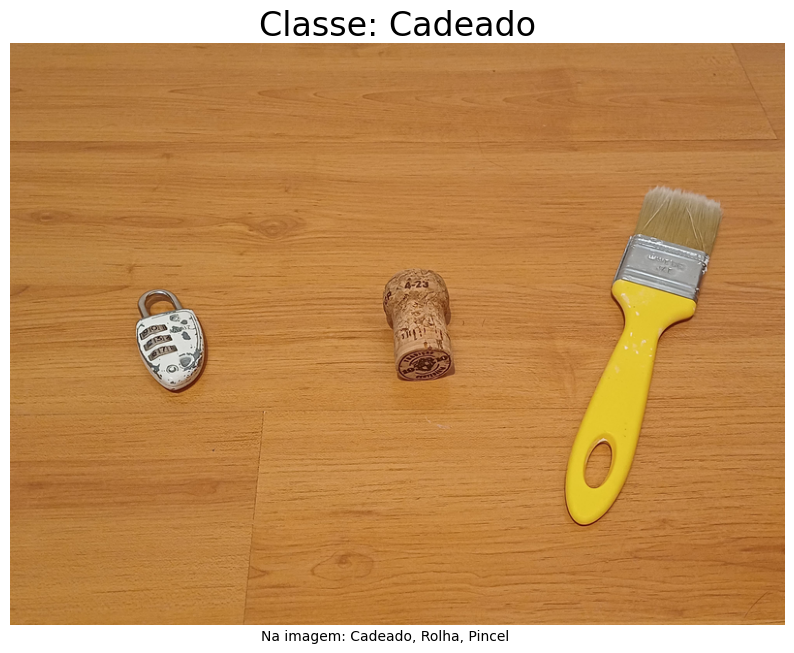

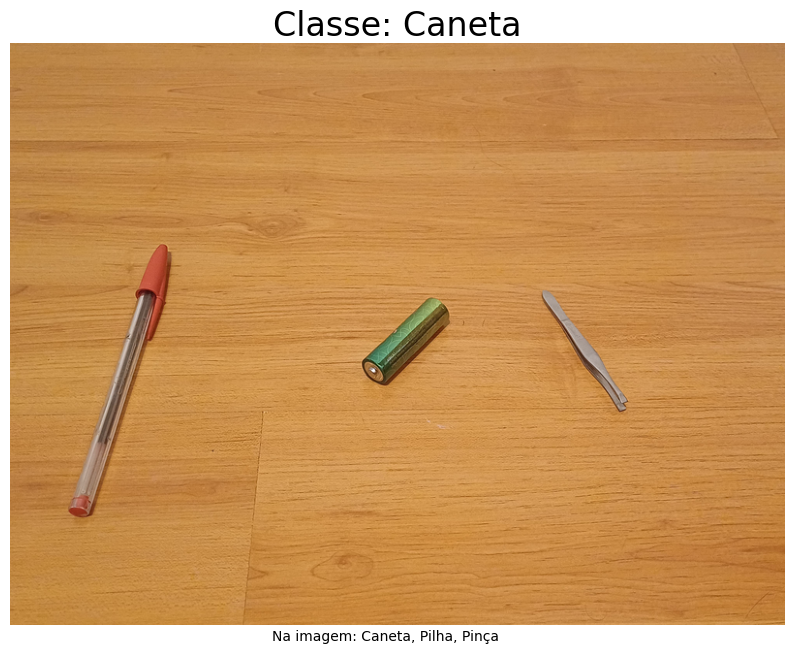

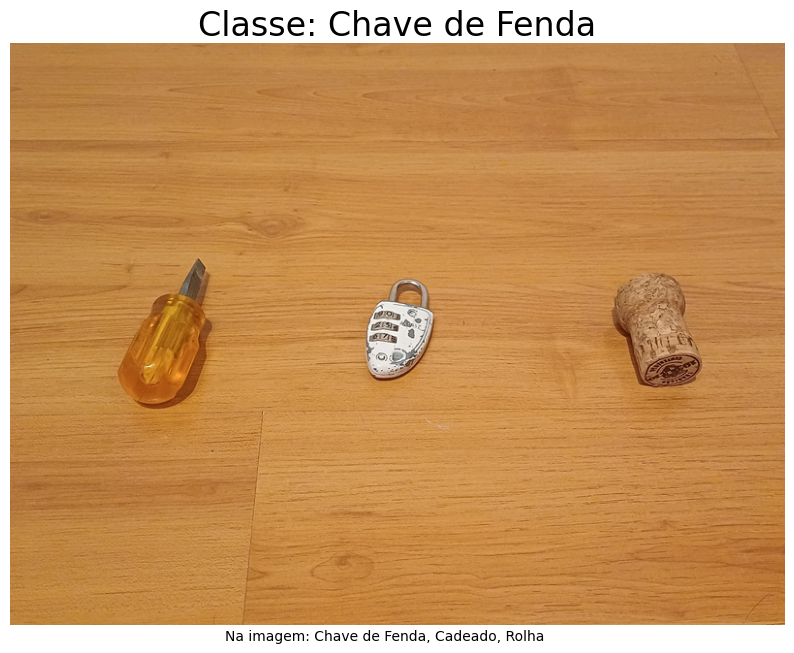

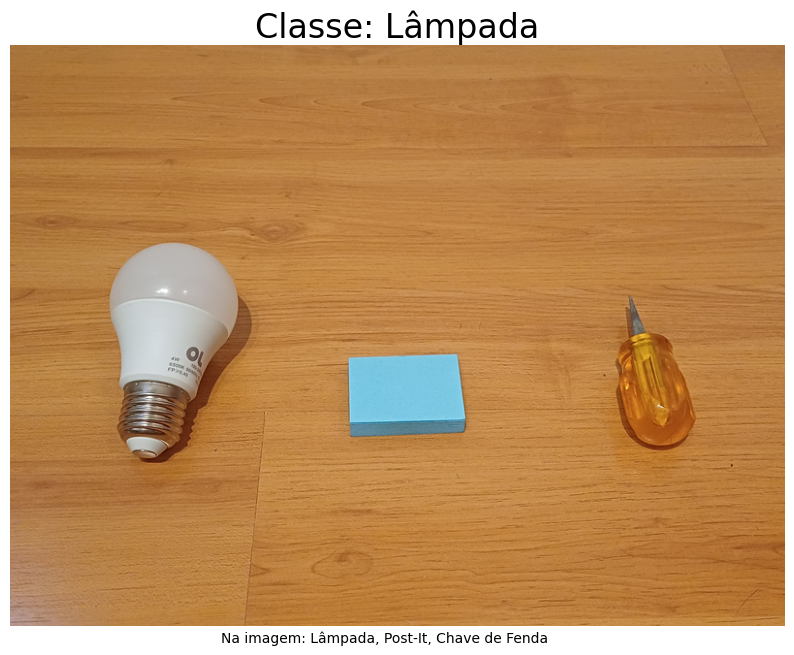

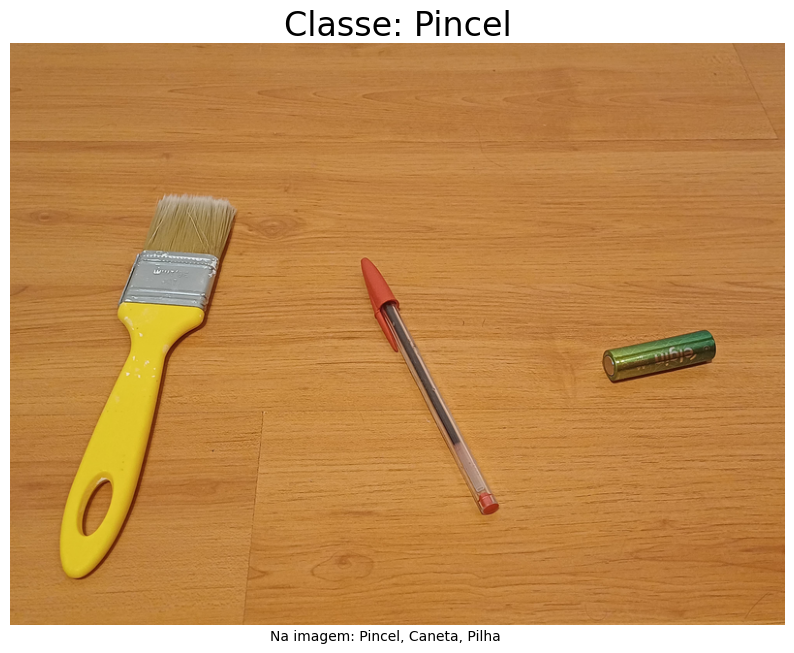

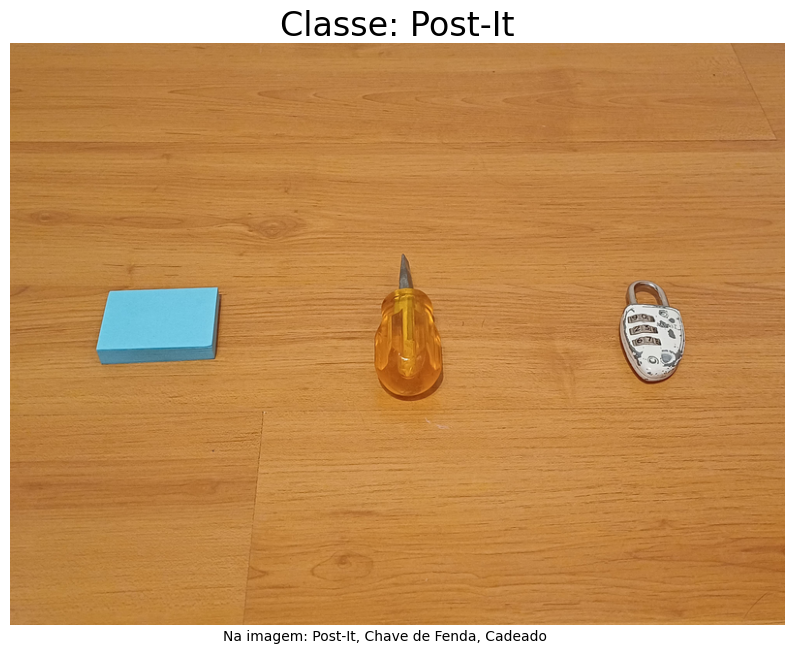

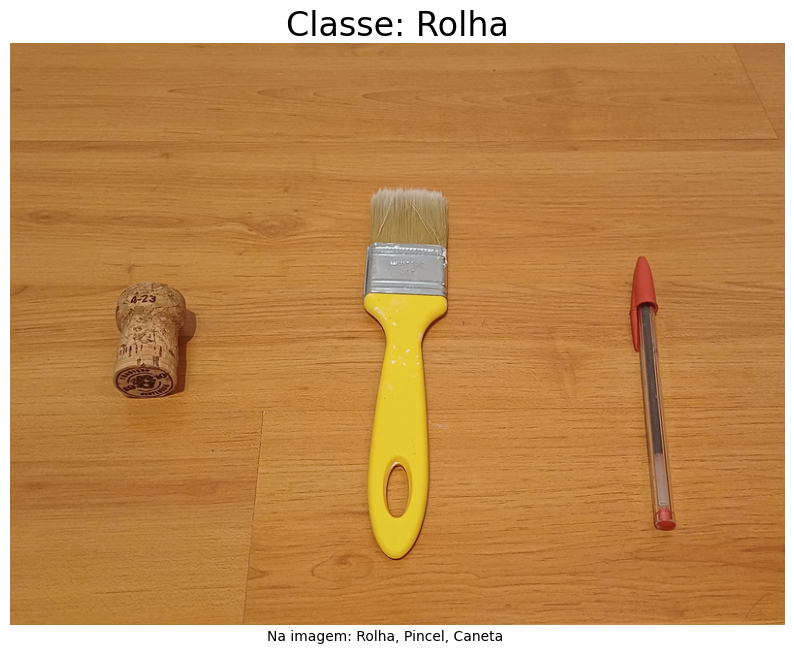

In [11]:
for classe, dados in metadados[metadados['Grupo'] == 1].groupby('Classe 1').first().iterrows():
    caminho_imagem = os.path.join(subdir, dados['Nome Arquivo'])
    imagem = mpimg.imread(caminho_imagem)
    plt.figure(figsize=(10, 10))
    plt.imshow(imagem)
    plt.title('Classe: ' + classe, fontsize=24)
    plt.suptitle('Na imagem: ' + dados['Descrição'], fontsize=10, y=0.2)  # Definindo o espaçamento vertical entre o título e o subtítulo
    plt.axis('off')
    plt.show()

## Contagem de Classes

In [12]:
contagem_total = metadados.melt(value_vars=['Classe 1', 'Classe 2', 'Classe 3'], value_name='Classe') \
    .groupby('Classe').size().reset_index(name='Total de Imagens')

contagem_por_plano_de_fundo = metadados.melt(value_vars=['Classe 1', 'Classe 2', 'Classe 3'], 
                                             id_vars=['Plano de Fundo'], value_name='Classe') \
    .groupby(['Plano de Fundo', 'Classe']).size().unstack(fill_value=0).reset_index()

contagem_por_luz = metadados.melt(value_vars=['Classe 1', 'Classe 2', 'Classe 3'], 
                                  id_vars=['Luz'], value_name='Classe') \
    .groupby(['Luz', 'Classe']).size().unstack(fill_value=0).reset_index()

contagem_por_ambiente = metadados.melt(value_vars=['Classe 1', 'Classe 2', 'Classe 3'], 
                                       id_vars=['Ambiente'], value_name='Classe') \
    .groupby(['Ambiente', 'Classe']).size().unstack(fill_value=0).reset_index()

print("Contagem Total:")
display(contagem_total)

print("\nContagem por Plano de Fundo:")
display(contagem_por_plano_de_fundo.T)

print("\nContagem por Luz:")
display(contagem_por_luz.T)

print("\nContagem por Ambiente:")
display(contagem_por_ambiente.T)

Contagem Total:


,Classe,Total de Imagens
0,Cadeado,180
1,Caneta,180
2,Chave de Fenda,180
3,Lâmpada,180
4,Pendrive,180
5,Pilha,180
6,Pincel,180
7,Pinça,180
8,Post-It,180
9,Rolha,180



Contagem por Plano de Fundo:


,0,1,2,3,4
Classe,,,,,
Plano de Fundo,Branco,Cimento,Concreto,Madeira,Pedra
Cadeado,36,36,36,36,36
Caneta,36,36,36,36,36
Chave de Fenda,36,36,36,36,36
Lâmpada,36,36,36,36,36
Pendrive,36,36,36,36,36
Pilha,36,36,36,36,36
Pincel,36,36,36,36,36
Pinça,36,36,36,36,36



Contagem por Luz:


,0,1,2,3,4
Classe,,,,,
Luz,Amarela,Branca,Indireta,Sol,Sombra
Cadeado,36,36,36,36,36
Caneta,36,36,36,36,36
Chave de Fenda,36,36,36,36,36
Lâmpada,36,36,36,36,36
Pendrive,36,36,36,36,36
Pilha,36,36,36,36,36
Pincel,36,36,36,36,36
Pinça,36,36,36,36,36



Contagem por Ambiente:


,0,1
Classe,,
Ambiente,Externo,Interno
Cadeado,72,108
Caneta,72,108
Chave de Fenda,72,108
Lâmpada,72,108
Pendrive,72,108
Pilha,72,108
Pincel,72,108
Pinça,72,108


## Explorar os Metadados

### Verificação dos valores possíveis das colunas string

In [13]:
for column in ['Grupo', 'Classe 1', 'Classe 2','Classe 3', 'Plano de Fundo', 'Luz', 'Ambiente', 'Média Histograma',
       'Mediana Histograma', 'Brilho']:
    display(column, metadados[column].unique())

'Grupo'

array([1, 2, 3, 4, 5], dtype=int64)

'Classe 1'

array(['Lâmpada', 'Post-It', 'Chave de Fenda', 'Cadeado', 'Rolha',
       'Pincel', 'Caneta', 'Pilha'], dtype=object)

'Classe 2'

array(['Post-It', 'Chave de Fenda', 'Cadeado', 'Rolha', 'Pincel',
       'Caneta', 'Pilha', 'Pinça'], dtype=object)

'Classe 3'

array(['Chave de Fenda', 'Cadeado', 'Rolha', 'Pincel', 'Caneta', 'Pilha',
       'Pinça', 'Pendrive'], dtype=object)

'Plano de Fundo'

array(['Madeira', 'Concreto', 'Branco', 'Cimento', 'Pedra'], dtype=object)

'Luz'

array(['Amarela', 'Sombra', 'Branca', 'Indireta', 'Sol'], dtype=object)

'Ambiente'

array(['Interno', 'Externo'], dtype=object)

'Média Histograma'

array([131, 129, 180,  24, 246])

'Mediana Histograma'

array([131, 126, 186,  21, 254])

'Brilho'

array(['Equilibrado', 'Escuro', 'Claro'], dtype=object)

### Verificação dos metadados quanto à valores vazios

In [14]:
metadados.isna().sum()

Grupo                 0
Descrição             0
Nome Arquivo          0
Classe 1              0
Classe 2              0
Classe 3              0
Plano de Fundo        0
Luz                   0
Ambiente              0
Média Histograma      0
Mediana Histograma    0
Brilho                0
dtype: int64

### Verificação dos metadados quanto à valores nulos

In [15]:
metadados.isnull().sum()

Grupo                 0
Descrição             0
Nome Arquivo          0
Classe 1              0
Classe 2              0
Classe 3              0
Plano de Fundo        0
Luz                   0
Ambiente              0
Média Histograma      0
Mediana Histograma    0
Brilho                0
dtype: int64

## Dicionário de Dados

* **Grupo** (int): Grupo ao qual a imagem pertence [1, 5]
* **Descrição** (string): String contendo as classes contidas na imagem, separadas por vírgula
* **Nome Arquivo** (string): Nome do arquivo da imagem no disco. As imagens estão no subdiretório ```/imagens/```
* **Classe 1** (string): Classe do primeiro objeto na imagem, da esquerda para direita.
    * Valores possíveis: ```['Lâmpada', 'Post-It', 'Chave de Fenda', 'Cadeado', 'Rolha', 'Pincel', 'Caneta', 'Pilha']```
* **Classe 2** (string): Classe do segundo objeto na imagem, da esquerda para direita.
    * Valores possíveis: ```['Lâmpada', 'Post-It', 'Chave de Fenda', 'Cadeado', 'Rolha', 'Pincel', 'Caneta', 'Pilha']```
* **Classe 3** (string): Classe do terceiro objeto na imagem, da esquerda para direita.
    * Valores possíveis: ```['Lâmpada', 'Post-It', 'Chave de Fenda', 'Cadeado', 'Rolha', 'Pincel', 'Caneta', 'Pilha']```
* **Plano de Fundo** (string): Descrição do fundo da imagem.
    * Valores possíveis: ```['Madeira', 'Concreto', 'Branco', 'Cimento', 'Pedra']```
* **Luz** (string): Descrição do tipo de luz incidente nos objetos no momento da foto.
    * Valores possíveis: ```['Amarela', 'Sombra', 'Branca', 'Indireta', 'Sol']```
* **Ambiente** (string): Descrição do ambiente onde as fotos foram efetuadas.
    * Valores possíveis: ```['Interno', 'Externo']```
* **Média Histograma** (int): Intensidade média do histograma [0, 255]
* **Mediana Histograma** (int): Intensidade mediana do histograma [0, 255]
* **Brilho** (string): Classificação do brilho médio da imagem para o grupo em que ela pertence.
    * Valores possíveis: ```['Equilibrado', 'Escuro', 'Claro']```
    * Os critérios para cada classificação são:
        * 'Equilibrado', se intensidade mediana e intensidade média entre 64 e 192
        * 'Escuro', se intensidade mediana e intensidade média menores que 64
        * 'Claro', se intensidade mediana e intensidade média maiores que 192

## Salvando os Metadados em Disco

In [16]:
metadados.to_csv('metadados_completo.csv', index = False)